# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

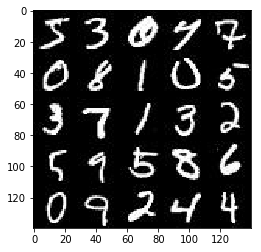

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

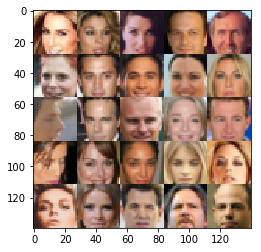

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


c:\users\andre\.conda\envs\dlnd\lib\site-packages\ipykernel_launcher.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.
  


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_input_image = tf.placeholder(tf.float32, shape=[None, image_width, image_height, image_channels], name = "Real_Input")
    z_data = tf.placeholder(tf.float32, shape=[None, z_dim], name = "Z_Input")
    lr = tf.placeholder(tf.float32, shape=[], name = "Learning_Rate")

    return real_input_image, z_data, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
def LReLU(logits, alpha=0.2):
    return tf.maximum(logits*alpha, logits)

def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        conv1 = tf.layers.conv2d(inputs=images, filters=64, kernel_size=(5,5),
                                  strides=(2,2), padding='same')
        lrelu1 = LReLU(conv1)     

        conv2 = tf.layers.conv2d(inputs=lrelu1, filters=128, kernel_size=(5,5),
                                  strides=(2,2), padding='same')
        bnorm1 = tf.layers.batch_normalization(conv2, training=True)
        lrelu2 = LReLU(bnorm1)
        
        conv3 = tf.layers.conv2d(inputs = lrelu2, filters=256, kernel_size=(5,5),
                                  strides=(2,2), padding='same')
        bnorm2 = tf.layers.batch_normalization(conv3, training=True)
        lrelu3 = LReLU(bnorm2)
        
        
        # 4th Convolutional Layer w/ LeakyReLU activation and batch norm
        conv4 = tf.layers.conv2d(inputs=lrelu3, filters=512, kernel_size=(5,5),
                                  strides=(2,2), padding='same')
        bnorm3 = tf.layers.batch_normalization(conv4, training=True)
        lrelu4 = LReLU(bnorm3)
        
        # Flattened Layer
        flat = tf.contrib.layers.flatten(lrelu4)
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [61]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse = not(is_train)):
        fc = tf.layers.dense(inputs = z, units = 3*3*512)
        fc = tf.reshape(fc, (-1, 3, 3, 512))
        fc = tf.layers.batch_normalization(fc, training=is_train)
        lrelu1 = LReLU(fc)
        
        conv1 = tf.layers.conv2d_transpose(inputs=lrelu1, filters=256, kernel_size=(5,5), strides=(1, 1), padding='valid')
        bnorm1 = tf.layers.batch_normalization(conv1, training=is_train)
        lrelu2 = LReLU(bnorm1)
        conv2 = tf.layers.conv2d_transpose(inputs=lrelu2, filters=128, kernel_size=(5,5), strides=(2, 2), padding='same')
        bnorm2 = tf.layers.batch_normalization(conv2, training=is_train)
        lrelu3 = LReLU(bnorm2)
        conv3 = tf.layers.conv2d_transpose(inputs=lrelu3, filters=64, kernel_size=(5,5), strides=(2, 2), padding='same')
        bnorm3 = tf.layers.batch_normalization(conv3, training=is_train)
        lrelu4 = LReLU(bnorm3)
        conv4 = tf.layers.conv2d_transpose(inputs=lrelu4, filters=32, kernel_size=(5,5), strides=(1,1), padding='same')
        bnorm4 = tf.layers.batch_normalization(conv4, training=is_train)
        lrelu5 = LReLU(bnorm4)
        out = tf.layers.conv2d_transpose(inputs=lrelu5, filters=out_channel_dim, 
                                            kernel_size=(5,5), strides=(1, 1),
                                            padding='same', activation = tf.tanh)
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [62]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim, is_train=True)
    (d_model_real, d_logits_real) = discriminator(input_real, reuse = False)
    (d_model_fake, d_logits_fake) = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)*0.97))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [63]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS) 
    with tf.control_dependencies([op for op in update_ops if op.name.startswith('generator')]):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [64]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [65]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    image_channels = data_shape[3]
    (input_real, input_z, lr) = model_inputs(image_width=data_shape[1], image_height=data_shape[2],
                                            image_channels=image_channels,z_dim=z_dim)
    
    (d_loss, g_loss) = model_loss(input_real, input_z, image_channels)
    (d_train_opt, g_train_opt) = model_opt(d_loss, g_loss, learning_rate, beta1)
    (samples, losses) = [], []
    print_every = 100
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            steps = 0
            for batch_images in get_batches(batch_size):
                steps += 1
                # TODO: Train Model
                batch_images *= 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_train_opt, feed_dict={input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_train_opt, feed_dict={input_z: batch_z, lr: learning_rate})
                if steps % 25 == 0:
                    show_generator_output(sess=sess, image_mode=data_image_mode,
                                          input_z=input_z, n_images=25,
                                          out_channel_dim=image_channels)
                    # get the losses and print them out
                    train_loss_d = sess.run(d_loss, {input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Batch {}".format(steps),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

In [ ]:
batch_size = 32
z_dim = 50
learning_rate = 0.01
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

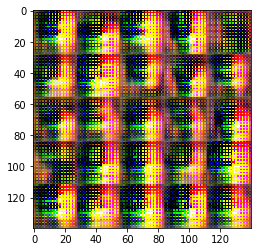

Epoch 1/1... Batch 25 Discriminator Loss: 2.7799... Generator Loss: 2.0977


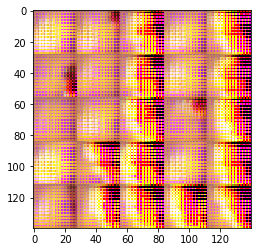

Epoch 1/1... Batch 50 Discriminator Loss: 1.4545... Generator Loss: 0.5268


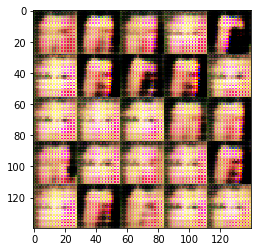

Epoch 1/1... Batch 75 Discriminator Loss: 1.7965... Generator Loss: 1.2706


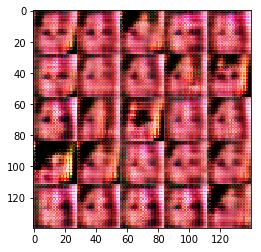

Epoch 1/1... Batch 100 Discriminator Loss: 2.0408... Generator Loss: 0.4201


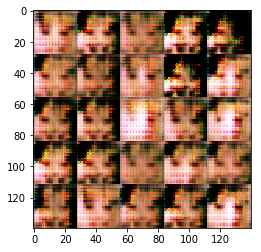

Epoch 1/1... Batch 125 Discriminator Loss: 1.4253... Generator Loss: 0.7032


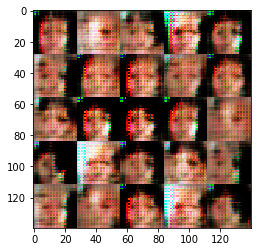

Epoch 1/1... Batch 150 Discriminator Loss: 1.3035... Generator Loss: 1.2043


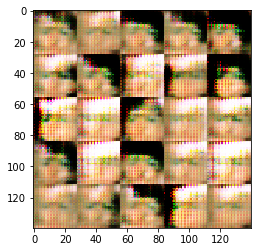

Epoch 1/1... Batch 175 Discriminator Loss: 1.2187... Generator Loss: 0.6511


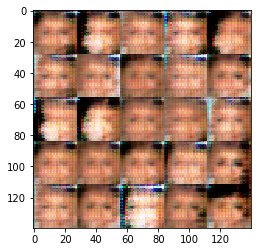

Epoch 1/1... Batch 200 Discriminator Loss: 1.4492... Generator Loss: 0.6681


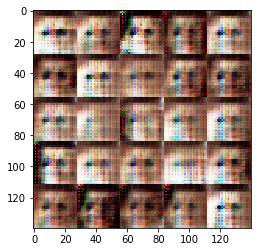

Epoch 1/1... Batch 225 Discriminator Loss: 1.4531... Generator Loss: 1.0503


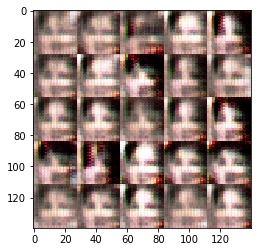

Epoch 1/1... Batch 250 Discriminator Loss: 1.4628... Generator Loss: 0.6661


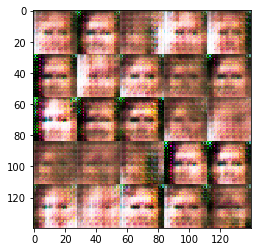

Epoch 1/1... Batch 275 Discriminator Loss: 1.8139... Generator Loss: 0.5511


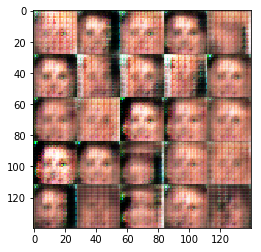

Epoch 1/1... Batch 300 Discriminator Loss: 1.3737... Generator Loss: 0.5604


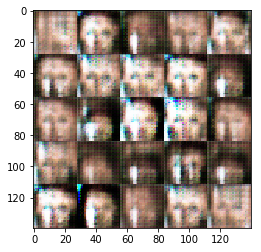

Epoch 1/1... Batch 325 Discriminator Loss: 1.2862... Generator Loss: 0.7649


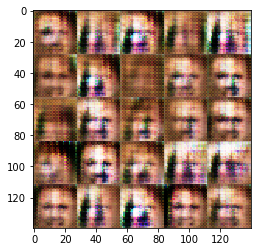

Epoch 1/1... Batch 350 Discriminator Loss: 1.6541... Generator Loss: 0.6317


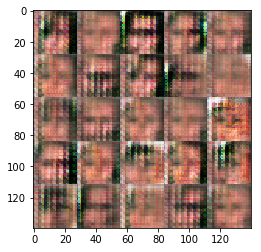

Epoch 1/1... Batch 375 Discriminator Loss: 1.3316... Generator Loss: 0.6248


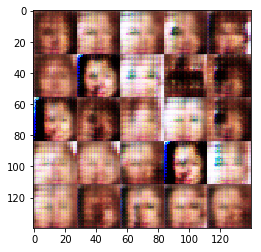

Epoch 1/1... Batch 400 Discriminator Loss: 1.3045... Generator Loss: 1.0211


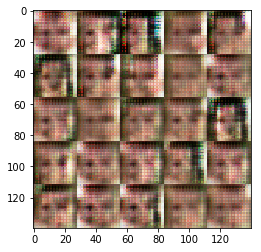

Epoch 1/1... Batch 425 Discriminator Loss: 1.4099... Generator Loss: 0.7776


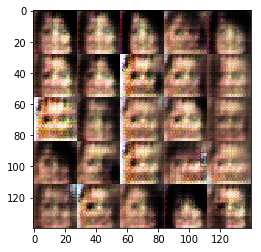

Epoch 1/1... Batch 450 Discriminator Loss: 1.4580... Generator Loss: 0.5204


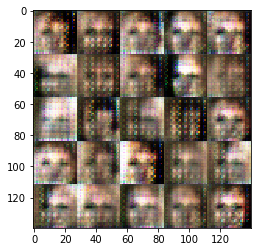

Epoch 1/1... Batch 475 Discriminator Loss: 1.3382... Generator Loss: 0.9420


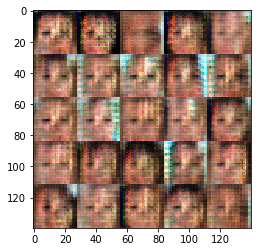

Epoch 1/1... Batch 500 Discriminator Loss: 1.2389... Generator Loss: 0.7913


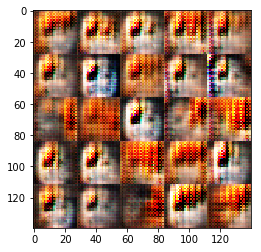

Epoch 1/1... Batch 525 Discriminator Loss: 1.7159... Generator Loss: 1.1361


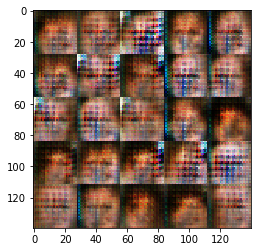

Epoch 1/1... Batch 550 Discriminator Loss: 1.2683... Generator Loss: 0.6614


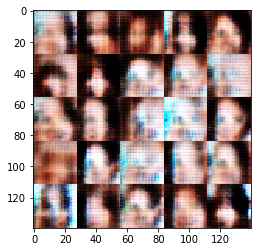

Epoch 1/1... Batch 575 Discriminator Loss: 1.4605... Generator Loss: 0.6985


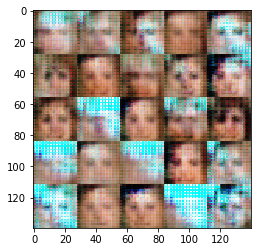

Epoch 1/1... Batch 600 Discriminator Loss: 1.3126... Generator Loss: 1.0289


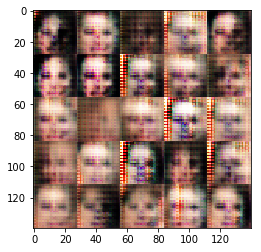

Epoch 1/1... Batch 625 Discriminator Loss: 1.5364... Generator Loss: 0.5681


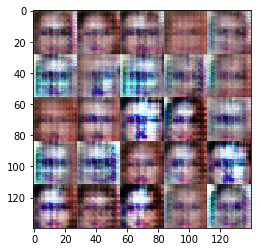

Epoch 1/1... Batch 650 Discriminator Loss: 1.2518... Generator Loss: 0.8893


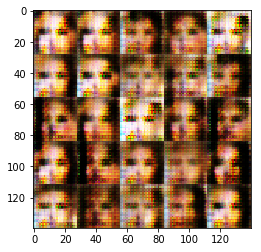

Epoch 1/1... Batch 675 Discriminator Loss: 1.5014... Generator Loss: 0.9500


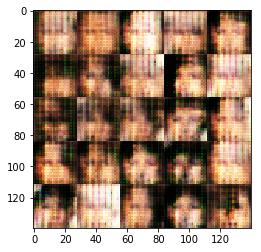

Epoch 1/1... Batch 700 Discriminator Loss: 1.4128... Generator Loss: 0.6104


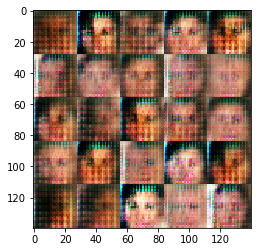

Epoch 1/1... Batch 725 Discriminator Loss: 1.4558... Generator Loss: 0.6040


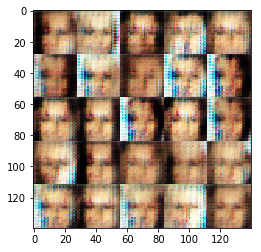

Epoch 1/1... Batch 750 Discriminator Loss: 1.3587... Generator Loss: 0.7164


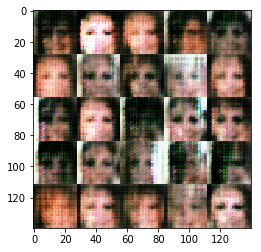

Epoch 1/1... Batch 775 Discriminator Loss: 1.3624... Generator Loss: 0.7338


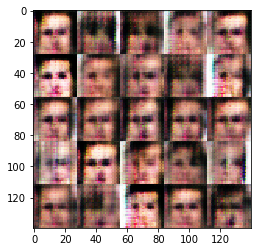

Epoch 1/1... Batch 800 Discriminator Loss: 1.4828... Generator Loss: 0.6943


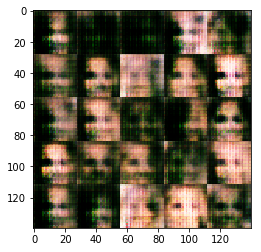

Epoch 1/1... Batch 825 Discriminator Loss: 1.4322... Generator Loss: 0.6781


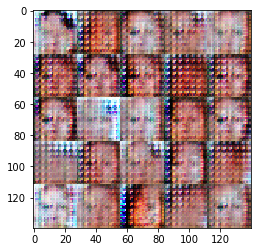

Epoch 1/1... Batch 850 Discriminator Loss: 1.2915... Generator Loss: 0.6345


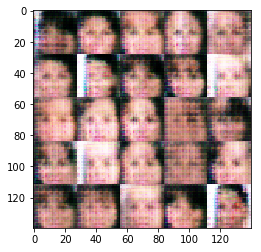

Epoch 1/1... Batch 875 Discriminator Loss: 1.4098... Generator Loss: 0.6900


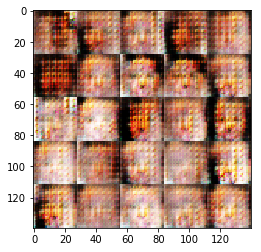

Epoch 1/1... Batch 900 Discriminator Loss: 1.4218... Generator Loss: 0.7665


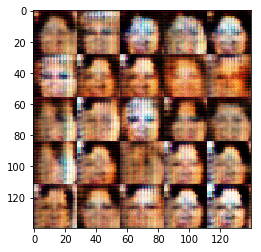

Epoch 1/1... Batch 925 Discriminator Loss: 1.3756... Generator Loss: 0.8862


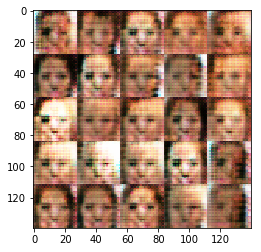

Epoch 1/1... Batch 950 Discriminator Loss: 1.4804... Generator Loss: 0.5767


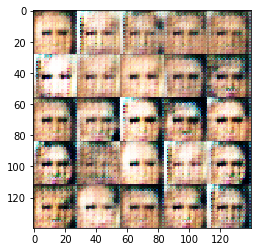

Epoch 1/1... Batch 975 Discriminator Loss: 1.5218... Generator Loss: 1.2567


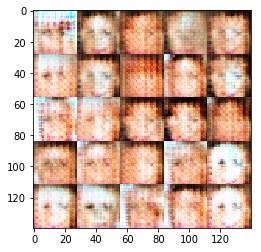

Epoch 1/1... Batch 1000 Discriminator Loss: 1.3360... Generator Loss: 0.7047


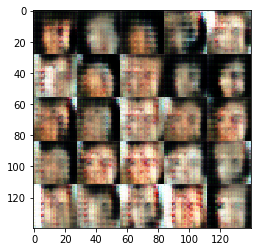

Epoch 1/1... Batch 1025 Discriminator Loss: 1.2826... Generator Loss: 0.8113


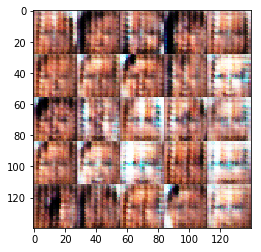

Epoch 1/1... Batch 1050 Discriminator Loss: 1.1960... Generator Loss: 0.7024


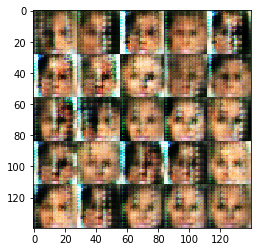

Epoch 1/1... Batch 1075 Discriminator Loss: 1.4356... Generator Loss: 0.6072


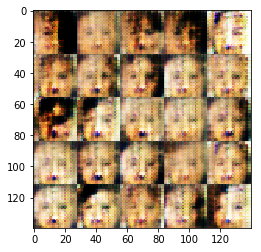

Epoch 1/1... Batch 1100 Discriminator Loss: 1.4540... Generator Loss: 0.8379


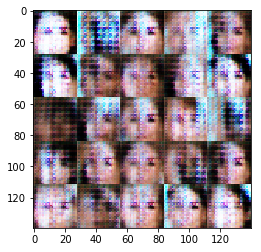

Epoch 1/1... Batch 1125 Discriminator Loss: 1.3395... Generator Loss: 0.7098


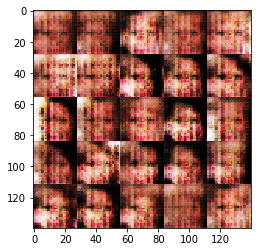

Epoch 1/1... Batch 1150 Discriminator Loss: 1.4576... Generator Loss: 1.0123


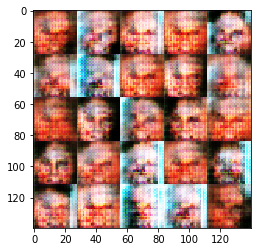

Epoch 1/1... Batch 1175 Discriminator Loss: 1.3661... Generator Loss: 0.6048


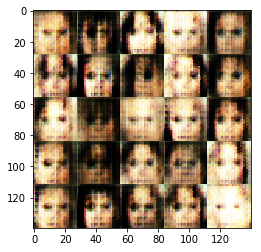

Epoch 1/1... Batch 1200 Discriminator Loss: 1.4454... Generator Loss: 0.7535


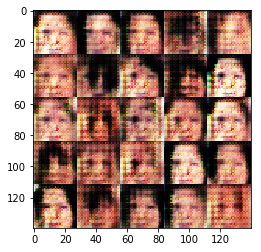

Epoch 1/1... Batch 1225 Discriminator Loss: 1.2599... Generator Loss: 0.7479


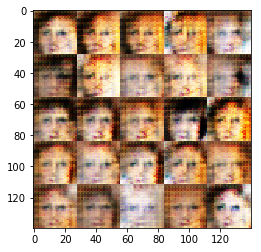

Epoch 1/1... Batch 1250 Discriminator Loss: 1.3333... Generator Loss: 0.7576


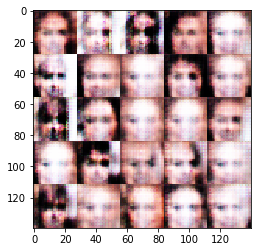

Epoch 1/1... Batch 1275 Discriminator Loss: 1.1170... Generator Loss: 0.7170


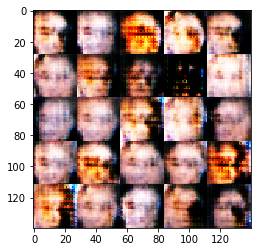

Epoch 1/1... Batch 1300 Discriminator Loss: 1.5303... Generator Loss: 0.5889


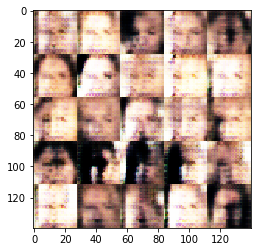

Epoch 1/1... Batch 1325 Discriminator Loss: 1.2349... Generator Loss: 0.8056


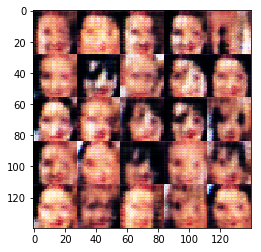

Epoch 1/1... Batch 1350 Discriminator Loss: 1.2173... Generator Loss: 1.0045


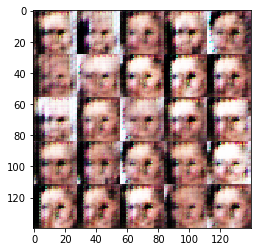

Epoch 1/1... Batch 1375 Discriminator Loss: 1.3512... Generator Loss: 0.8527


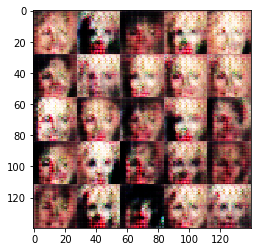

Epoch 1/1... Batch 1400 Discriminator Loss: 1.0503... Generator Loss: 0.7928


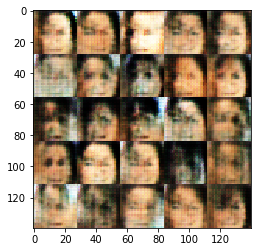

Epoch 1/1... Batch 1425 Discriminator Loss: 1.3864... Generator Loss: 0.6003


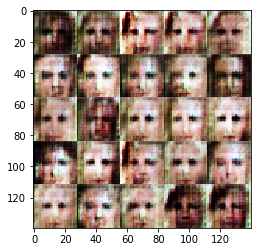

Epoch 1/1... Batch 1450 Discriminator Loss: 1.3281... Generator Loss: 0.5432


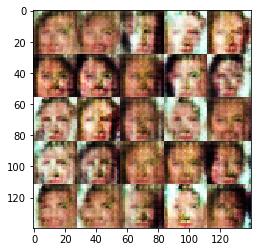

Epoch 1/1... Batch 1475 Discriminator Loss: 1.3961... Generator Loss: 0.5644


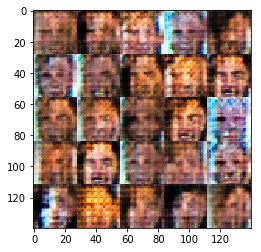

Epoch 1/1... Batch 1500 Discriminator Loss: 1.4121... Generator Loss: 0.6304


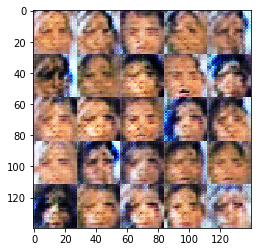

Epoch 1/1... Batch 1525 Discriminator Loss: 1.4601... Generator Loss: 0.4473


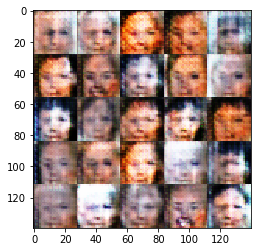

Epoch 1/1... Batch 1550 Discriminator Loss: 1.4331... Generator Loss: 0.6410


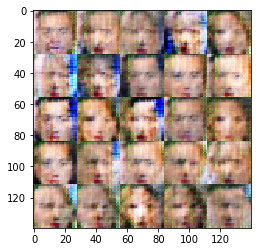

Epoch 1/1... Batch 1575 Discriminator Loss: 1.4572... Generator Loss: 0.5834


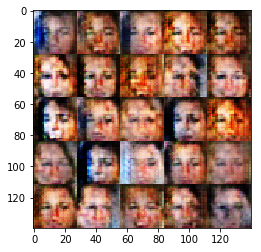

Epoch 1/1... Batch 1600 Discriminator Loss: 1.2964... Generator Loss: 0.7234


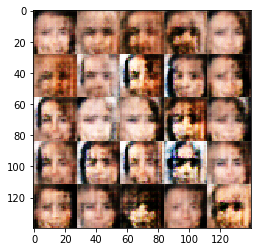

Epoch 1/1... Batch 1625 Discriminator Loss: 1.0743... Generator Loss: 0.9849


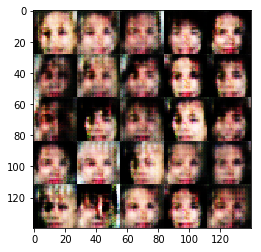

Epoch 1/1... Batch 1650 Discriminator Loss: 1.4004... Generator Loss: 0.7519


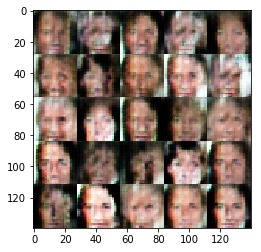

Epoch 1/1... Batch 1675 Discriminator Loss: 1.3991... Generator Loss: 0.7329


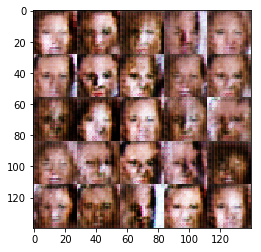

Epoch 1/1... Batch 1700 Discriminator Loss: 1.1647... Generator Loss: 0.9566


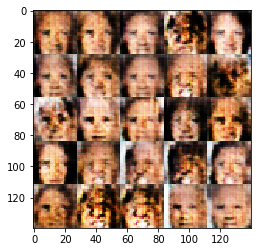

Epoch 1/1... Batch 1725 Discriminator Loss: 1.2903... Generator Loss: 0.6576


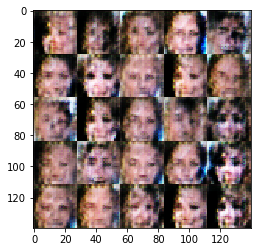

Epoch 1/1... Batch 1750 Discriminator Loss: 1.3193... Generator Loss: 0.5858


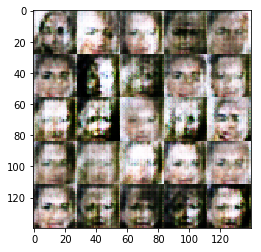

Epoch 1/1... Batch 1775 Discriminator Loss: 1.5439... Generator Loss: 0.5078


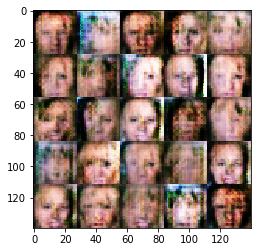

Epoch 1/1... Batch 1800 Discriminator Loss: 1.5792... Generator Loss: 0.7448


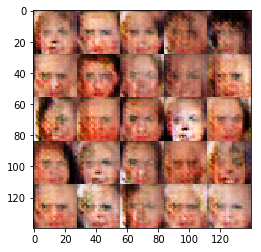

Epoch 1/1... Batch 1825 Discriminator Loss: 1.3801... Generator Loss: 0.6322


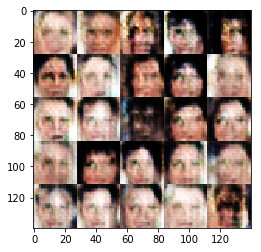

Epoch 1/1... Batch 1850 Discriminator Loss: 1.2843... Generator Loss: 0.6897


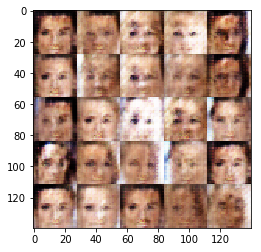

Epoch 1/1... Batch 1875 Discriminator Loss: 1.3407... Generator Loss: 0.7832


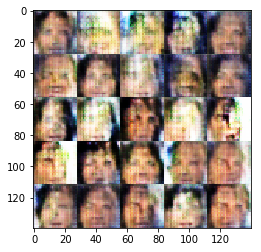

Epoch 1/1... Batch 1900 Discriminator Loss: 1.1732... Generator Loss: 0.8564


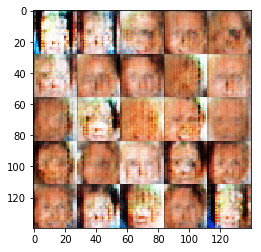

Epoch 1/1... Batch 1925 Discriminator Loss: 1.1887... Generator Loss: 0.6835


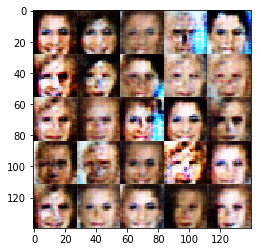

Epoch 1/1... Batch 1950 Discriminator Loss: 1.5677... Generator Loss: 0.4354


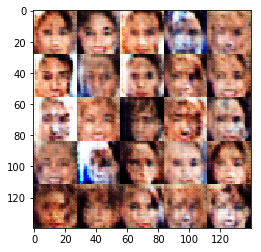

Epoch 1/1... Batch 1975 Discriminator Loss: 1.3940... Generator Loss: 0.6718


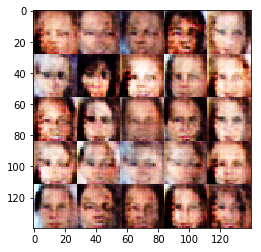

Epoch 1/1... Batch 2000 Discriminator Loss: 1.3759... Generator Loss: 0.6314


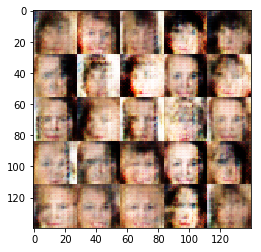

Epoch 1/1... Batch 2025 Discriminator Loss: 2.1194... Generator Loss: 1.5259


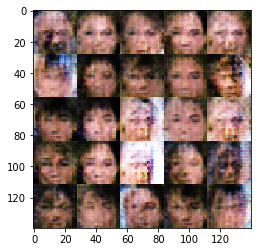

Epoch 1/1... Batch 2050 Discriminator Loss: 1.3537... Generator Loss: 0.6371


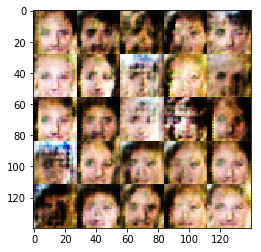

Epoch 1/1... Batch 2075 Discriminator Loss: 1.2992... Generator Loss: 1.0952


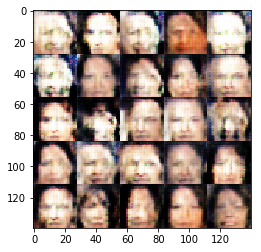

Epoch 1/1... Batch 2100 Discriminator Loss: 1.3192... Generator Loss: 0.5329


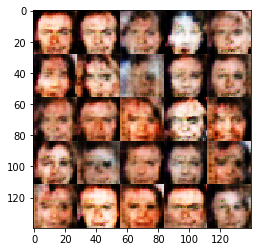

Epoch 1/1... Batch 2125 Discriminator Loss: 1.5271... Generator Loss: 0.5267


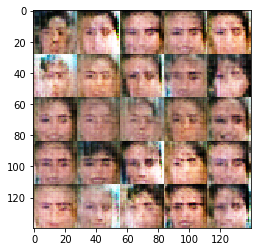

Epoch 1/1... Batch 2150 Discriminator Loss: 1.4751... Generator Loss: 0.6022


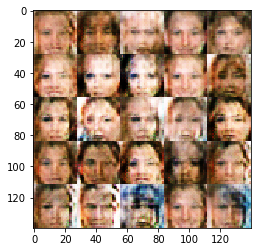

Epoch 1/1... Batch 2175 Discriminator Loss: 1.3982... Generator Loss: 0.5429


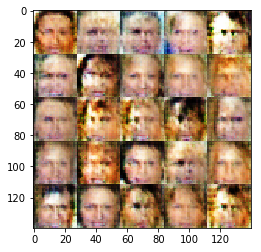

Epoch 1/1... Batch 2200 Discriminator Loss: 1.4135... Generator Loss: 0.5815


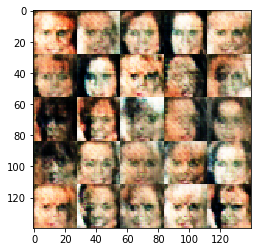

Epoch 1/1... Batch 2225 Discriminator Loss: 1.2652... Generator Loss: 0.7659


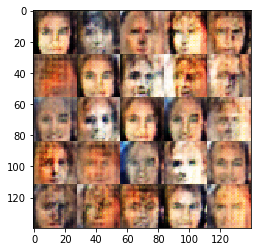

Epoch 1/1... Batch 2250 Discriminator Loss: 1.3463... Generator Loss: 0.6475


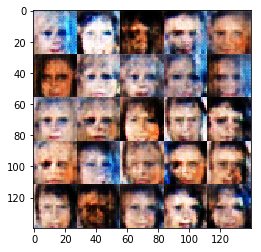

Epoch 1/1... Batch 2275 Discriminator Loss: 1.4952... Generator Loss: 0.4401


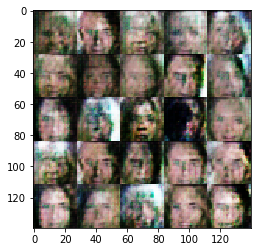

Epoch 1/1... Batch 2300 Discriminator Loss: 1.4090... Generator Loss: 0.7361


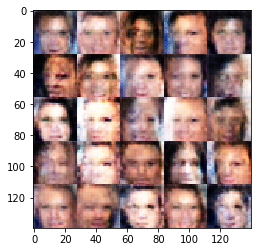

Epoch 1/1... Batch 2325 Discriminator Loss: 1.6370... Generator Loss: 0.3712


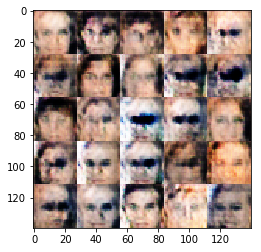

Epoch 1/1... Batch 2350 Discriminator Loss: 1.4472... Generator Loss: 0.5356


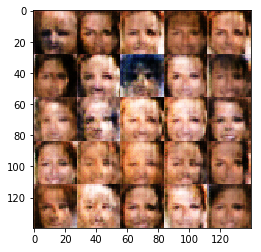

Epoch 1/1... Batch 2375 Discriminator Loss: 1.3870... Generator Loss: 0.5726


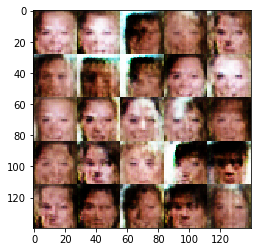

Epoch 1/1... Batch 2400 Discriminator Loss: 1.5956... Generator Loss: 0.4003


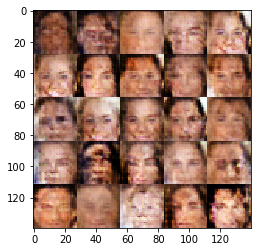

Epoch 1/1... Batch 2425 Discriminator Loss: 1.3127... Generator Loss: 0.8612


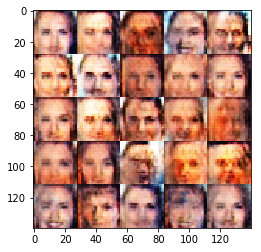

Epoch 1/1... Batch 2450 Discriminator Loss: 1.3177... Generator Loss: 0.6488


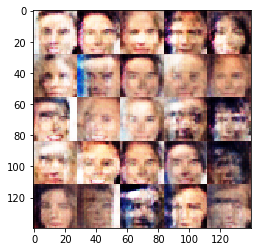

Epoch 1/1... Batch 2475 Discriminator Loss: 1.5268... Generator Loss: 0.5327


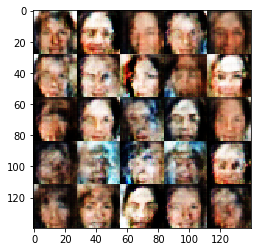

Epoch 1/1... Batch 2500 Discriminator Loss: 1.4182... Generator Loss: 0.5533


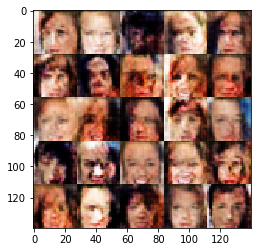

Epoch 1/1... Batch 2525 Discriminator Loss: 1.4396... Generator Loss: 0.4962


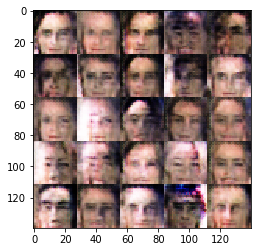

Epoch 1/1... Batch 2550 Discriminator Loss: 1.4264... Generator Loss: 0.5587


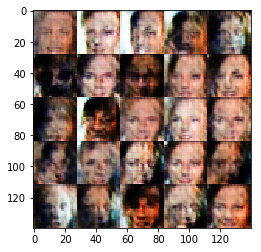

Epoch 1/1... Batch 2575 Discriminator Loss: 1.4497... Generator Loss: 0.7491


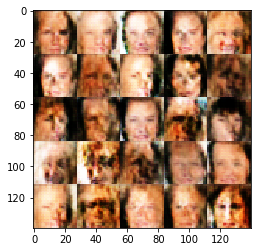

Epoch 1/1... Batch 2600 Discriminator Loss: 1.3476... Generator Loss: 0.6204


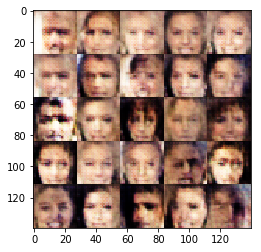

Epoch 1/1... Batch 2625 Discriminator Loss: 1.2666... Generator Loss: 0.6773


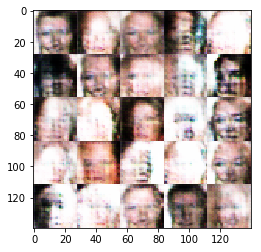

Epoch 1/1... Batch 2650 Discriminator Loss: 1.3154... Generator Loss: 0.9500


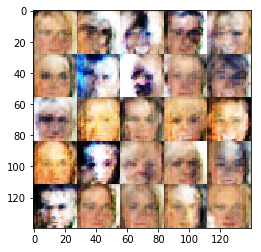

Epoch 1/1... Batch 2675 Discriminator Loss: 1.3542... Generator Loss: 0.6759


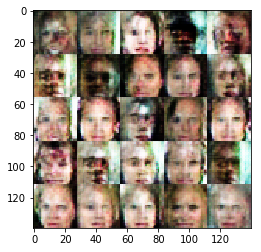

Epoch 1/1... Batch 2700 Discriminator Loss: 1.3989... Generator Loss: 0.6370


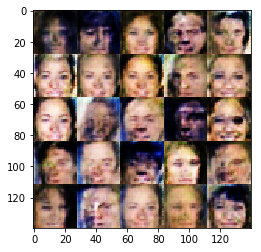

Epoch 1/1... Batch 2725 Discriminator Loss: 1.5427... Generator Loss: 0.3963


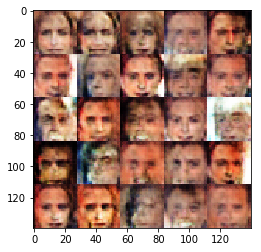

Epoch 1/1... Batch 2750 Discriminator Loss: 1.4153... Generator Loss: 0.8573


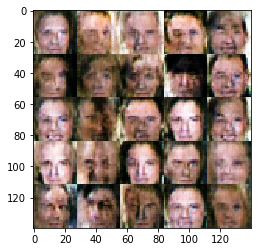

Epoch 1/1... Batch 2775 Discriminator Loss: 1.3948... Generator Loss: 0.5132


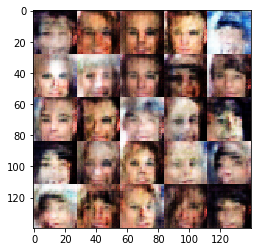

Epoch 1/1... Batch 2800 Discriminator Loss: 1.3878... Generator Loss: 0.6571


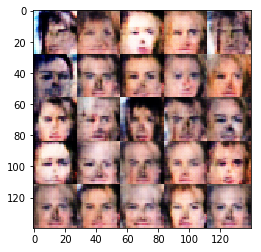

Epoch 1/1... Batch 2825 Discriminator Loss: 1.2909... Generator Loss: 0.7930


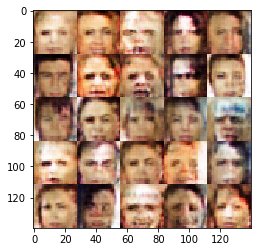

Epoch 1/1... Batch 2850 Discriminator Loss: 1.2913... Generator Loss: 0.7513


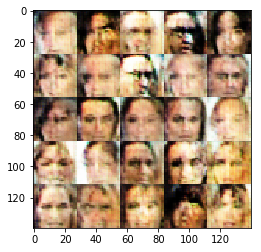

Epoch 1/1... Batch 2875 Discriminator Loss: 1.3833... Generator Loss: 0.6971


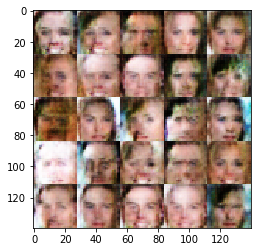

Epoch 1/1... Batch 2900 Discriminator Loss: 1.8215... Generator Loss: 0.2711


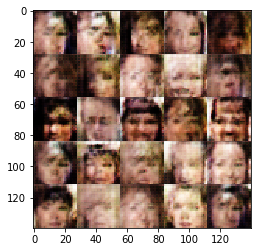

Epoch 1/1... Batch 2925 Discriminator Loss: 1.3102... Generator Loss: 0.7870


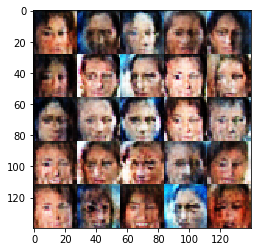

Epoch 1/1... Batch 2950 Discriminator Loss: 1.3812... Generator Loss: 0.8689


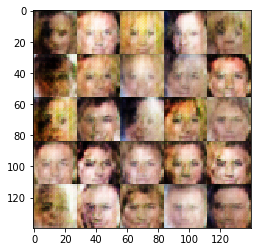

Epoch 1/1... Batch 2975 Discriminator Loss: 1.2841... Generator Loss: 0.7221


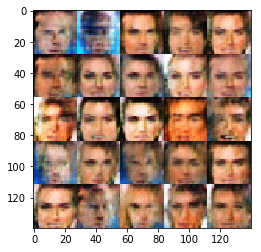

Epoch 1/1... Batch 3000 Discriminator Loss: 1.3006... Generator Loss: 0.6258


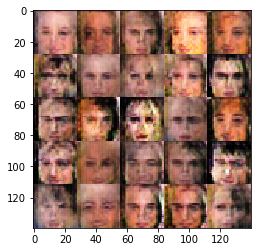

Epoch 1/1... Batch 3025 Discriminator Loss: 1.2564... Generator Loss: 0.8085


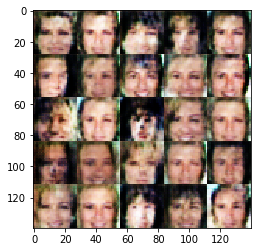

Epoch 1/1... Batch 3050 Discriminator Loss: 1.3054... Generator Loss: 0.8267


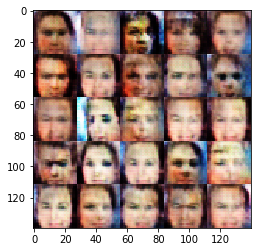

Epoch 1/1... Batch 3075 Discriminator Loss: 1.4513... Generator Loss: 0.5145


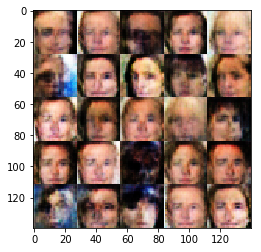

Epoch 1/1... Batch 3100 Discriminator Loss: 1.5024... Generator Loss: 0.5178


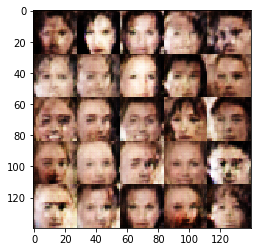

Epoch 1/1... Batch 3125 Discriminator Loss: 1.2771... Generator Loss: 0.6290


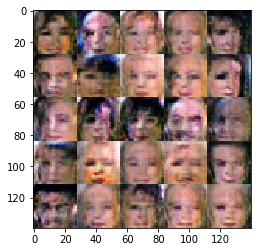

Epoch 1/1... Batch 3150 Discriminator Loss: 1.4904... Generator Loss: 0.5337


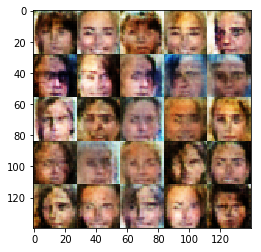

Epoch 1/1... Batch 3175 Discriminator Loss: 1.7473... Generator Loss: 0.2822


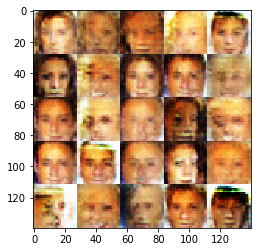

Epoch 1/1... Batch 3200 Discriminator Loss: 1.2814... Generator Loss: 0.5818


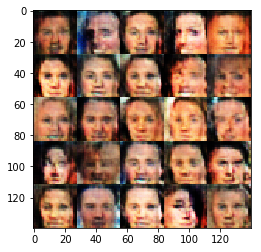

Epoch 1/1... Batch 3225 Discriminator Loss: 1.2667... Generator Loss: 0.8507


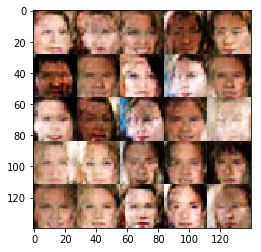

Epoch 1/1... Batch 3250 Discriminator Loss: 1.3461... Generator Loss: 0.7048


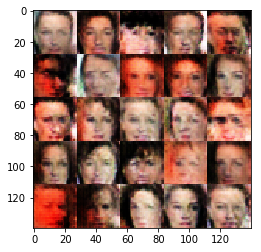

Epoch 1/1... Batch 3275 Discriminator Loss: 1.3908... Generator Loss: 0.6810


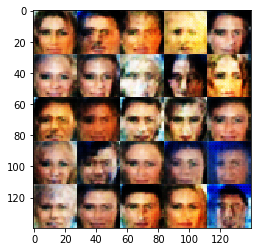

Epoch 1/1... Batch 3300 Discriminator Loss: 1.5962... Generator Loss: 0.4896


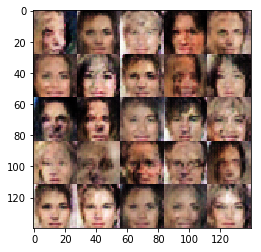

Epoch 1/1... Batch 3325 Discriminator Loss: 1.3883... Generator Loss: 0.6984


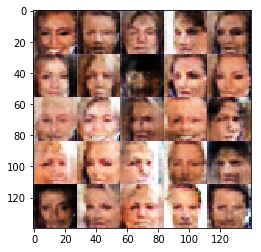

Epoch 1/1... Batch 3350 Discriminator Loss: 1.3403... Generator Loss: 0.5617


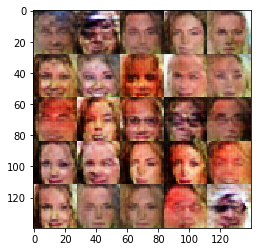

Epoch 1/1... Batch 3375 Discriminator Loss: 1.4238... Generator Loss: 0.5909


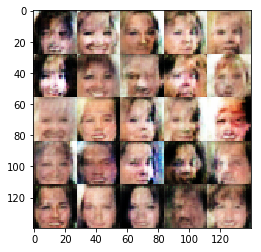

Epoch 1/1... Batch 3400 Discriminator Loss: 1.4471... Generator Loss: 0.6991


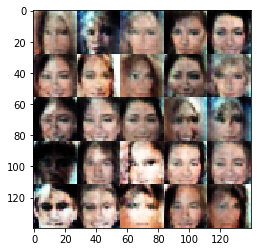

Epoch 1/1... Batch 3425 Discriminator Loss: 1.2480... Generator Loss: 0.7360


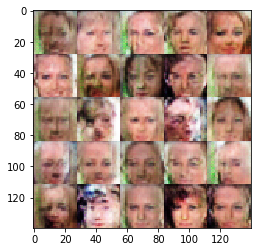

Epoch 1/1... Batch 3450 Discriminator Loss: 1.4895... Generator Loss: 0.4793


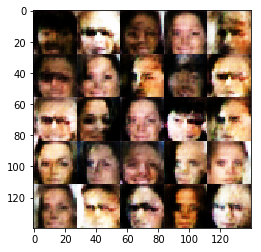

Epoch 1/1... Batch 3475 Discriminator Loss: 1.4775... Generator Loss: 0.8415


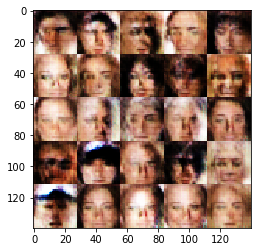

Epoch 1/1... Batch 3500 Discriminator Loss: 1.7970... Generator Loss: 1.8135


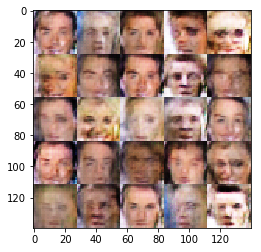

Epoch 1/1... Batch 3525 Discriminator Loss: 1.4354... Generator Loss: 0.5326


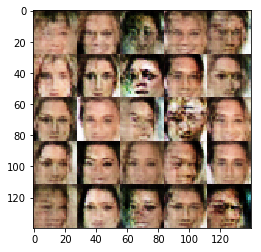

Epoch 1/1... Batch 3550 Discriminator Loss: 1.4255... Generator Loss: 0.6740


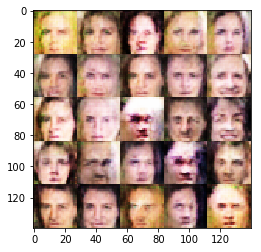

Epoch 1/1... Batch 3575 Discriminator Loss: 1.4306... Generator Loss: 0.6926


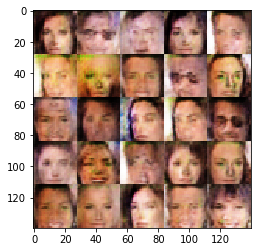

Epoch 1/1... Batch 3600 Discriminator Loss: 1.3646... Generator Loss: 0.6242


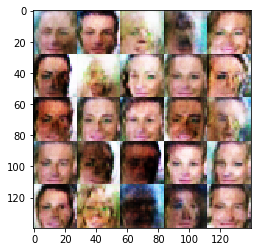

Epoch 1/1... Batch 3625 Discriminator Loss: 1.4339... Generator Loss: 0.5786


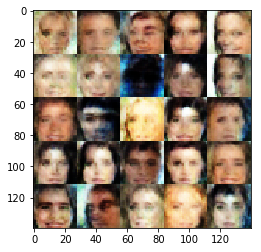

Epoch 1/1... Batch 3650 Discriminator Loss: 1.4726... Generator Loss: 0.7077


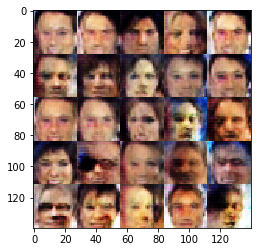

Epoch 1/1... Batch 3675 Discriminator Loss: 1.3457... Generator Loss: 0.6954


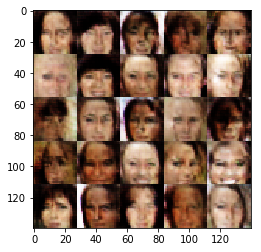

Epoch 1/1... Batch 3700 Discriminator Loss: 1.3383... Generator Loss: 0.7786


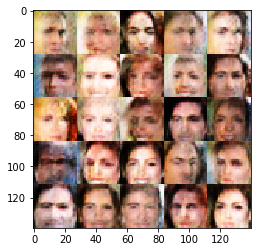

Epoch 1/1... Batch 3725 Discriminator Loss: 1.4007... Generator Loss: 0.5780


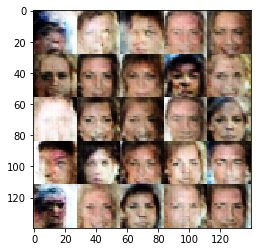

Epoch 1/1... Batch 3750 Discriminator Loss: 1.2227... Generator Loss: 0.6316


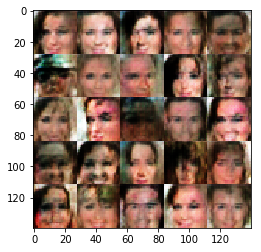

Epoch 1/1... Batch 3775 Discriminator Loss: 1.3678... Generator Loss: 0.6253


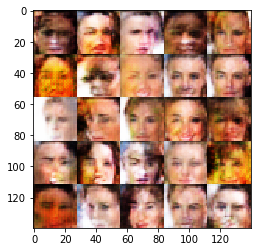

Epoch 1/1... Batch 3800 Discriminator Loss: 1.6792... Generator Loss: 0.3014


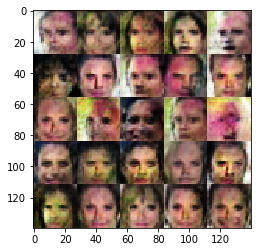

Epoch 1/1... Batch 3825 Discriminator Loss: 1.3606... Generator Loss: 0.5616


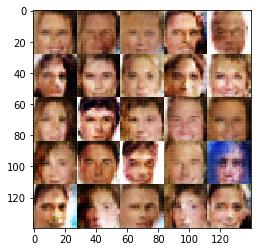

Epoch 1/1... Batch 3850 Discriminator Loss: 1.4370... Generator Loss: 0.5627


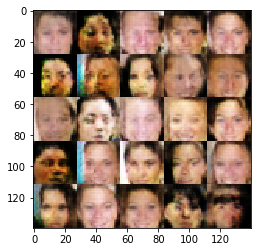

Epoch 1/1... Batch 3875 Discriminator Loss: 1.4757... Generator Loss: 0.6162


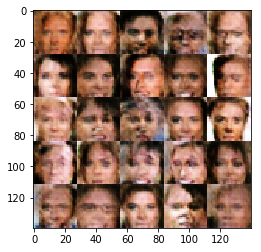

Epoch 1/1... Batch 3900 Discriminator Loss: 1.3802... Generator Loss: 0.5880


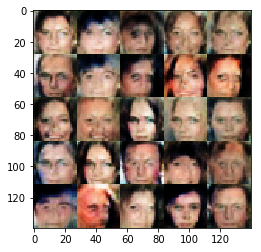

Epoch 1/1... Batch 3925 Discriminator Loss: 1.3596... Generator Loss: 0.6841


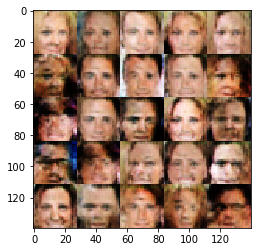

Epoch 1/1... Batch 3950 Discriminator Loss: 1.3589... Generator Loss: 0.7714


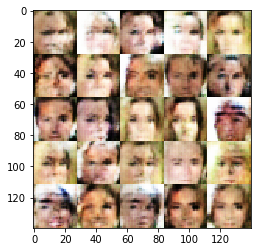

Epoch 1/1... Batch 3975 Discriminator Loss: 1.3919... Generator Loss: 0.9991


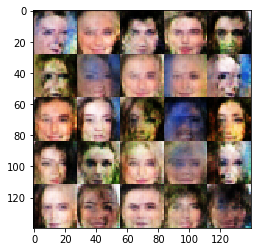

Epoch 1/1... Batch 4000 Discriminator Loss: 1.3948... Generator Loss: 0.7045


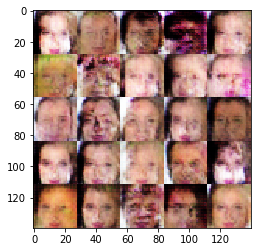

Epoch 1/1... Batch 4025 Discriminator Loss: 1.4799... Generator Loss: 0.7121


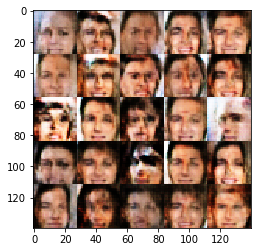

Epoch 1/1... Batch 4050 Discriminator Loss: 1.2970... Generator Loss: 0.6965


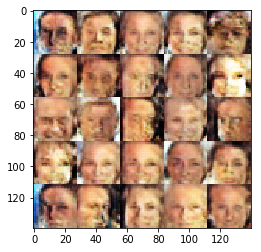

Epoch 1/1... Batch 4075 Discriminator Loss: 1.2495... Generator Loss: 0.6954


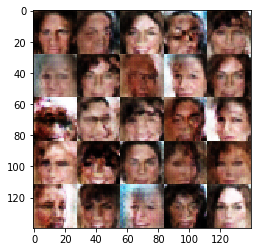

Epoch 1/1... Batch 4100 Discriminator Loss: 1.4336... Generator Loss: 0.4888


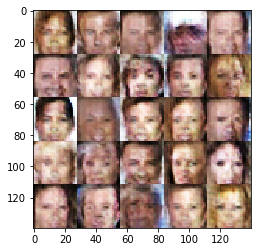

Epoch 1/1... Batch 4125 Discriminator Loss: 1.3140... Generator Loss: 0.5975


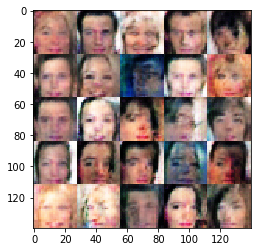

Epoch 1/1... Batch 4150 Discriminator Loss: 1.6906... Generator Loss: 0.3037


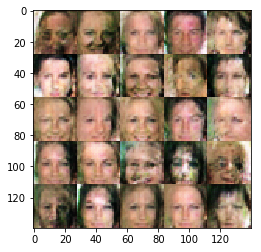

Epoch 1/1... Batch 4175 Discriminator Loss: 1.4021... Generator Loss: 0.6381


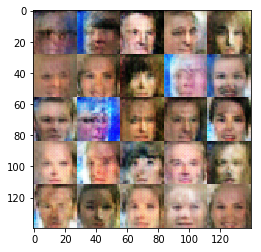

Epoch 1/1... Batch 4200 Discriminator Loss: 1.2784... Generator Loss: 0.5606


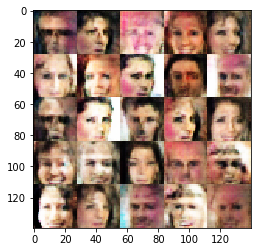

Epoch 1/1... Batch 4225 Discriminator Loss: 1.4328... Generator Loss: 0.6392


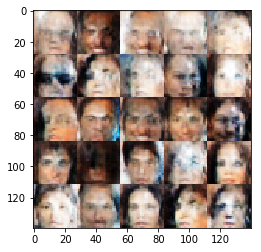

Epoch 1/1... Batch 4250 Discriminator Loss: 1.3278... Generator Loss: 0.6164


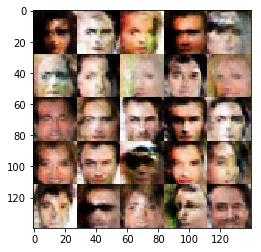

Epoch 1/1... Batch 4275 Discriminator Loss: 1.4672... Generator Loss: 0.4824


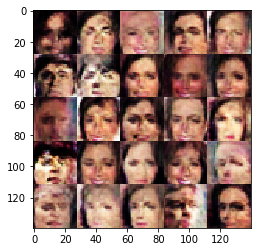

Epoch 1/1... Batch 4300 Discriminator Loss: 1.2545... Generator Loss: 0.8038


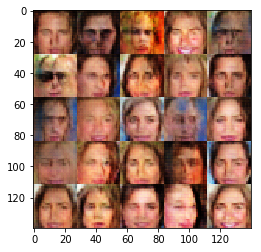

Epoch 1/1... Batch 4325 Discriminator Loss: 1.3870... Generator Loss: 0.5915


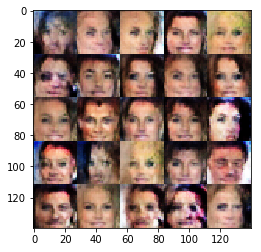

Epoch 1/1... Batch 4350 Discriminator Loss: 1.3809... Generator Loss: 0.5698


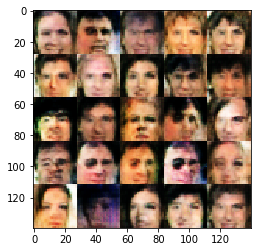

Epoch 1/1... Batch 4375 Discriminator Loss: 1.4176... Generator Loss: 0.4317


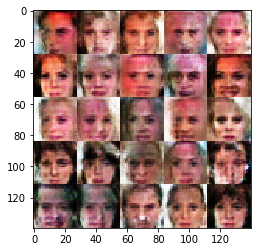

Epoch 1/1... Batch 4400 Discriminator Loss: 1.3320... Generator Loss: 0.7083


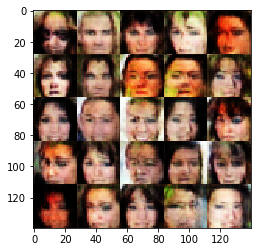

Epoch 1/1... Batch 4425 Discriminator Loss: 1.2900... Generator Loss: 0.7923


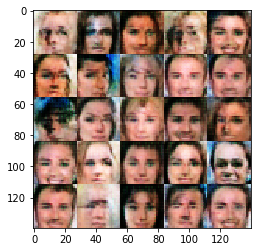

Epoch 1/1... Batch 4450 Discriminator Loss: 1.2431... Generator Loss: 0.7587


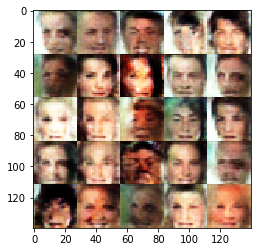

Epoch 1/1... Batch 4475 Discriminator Loss: 1.6692... Generator Loss: 0.3319


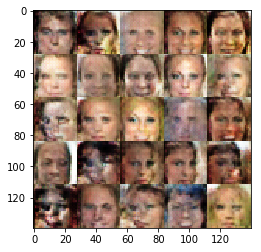

Epoch 1/1... Batch 4500 Discriminator Loss: 1.3584... Generator Loss: 0.5825


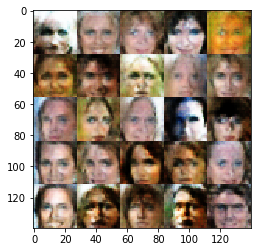

Epoch 1/1... Batch 4525 Discriminator Loss: 1.2002... Generator Loss: 0.8491


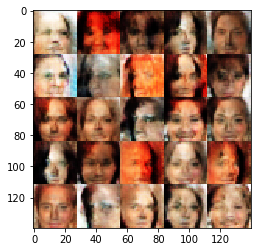

Epoch 1/1... Batch 4550 Discriminator Loss: 1.4206... Generator Loss: 0.5546


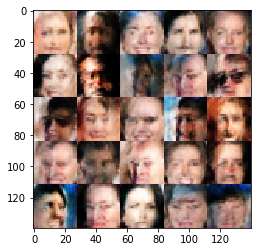

Epoch 1/1... Batch 4575 Discriminator Loss: 1.4437... Generator Loss: 1.0852


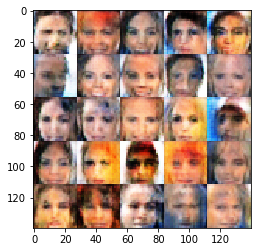

Epoch 1/1... Batch 4600 Discriminator Loss: 1.3471... Generator Loss: 0.6035


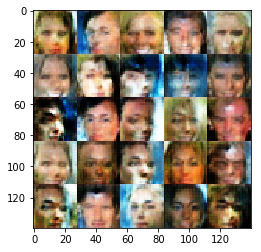

Epoch 1/1... Batch 4625 Discriminator Loss: 1.2960... Generator Loss: 0.9465


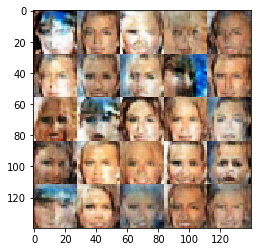

Epoch 1/1... Batch 4650 Discriminator Loss: 1.5359... Generator Loss: 0.7542


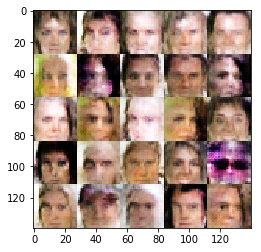

Epoch 1/1... Batch 4675 Discriminator Loss: 1.3560... Generator Loss: 0.6479


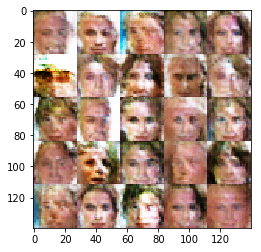

Epoch 1/1... Batch 4700 Discriminator Loss: 1.4988... Generator Loss: 1.0885


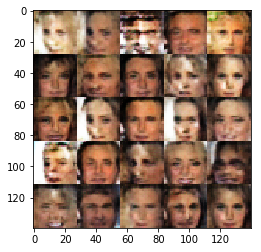

Epoch 1/1... Batch 4725 Discriminator Loss: 1.2194... Generator Loss: 0.6813


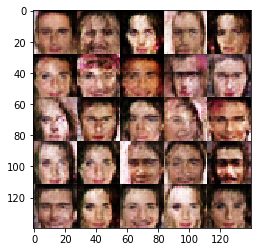

Epoch 1/1... Batch 4750 Discriminator Loss: 1.4139... Generator Loss: 0.4898


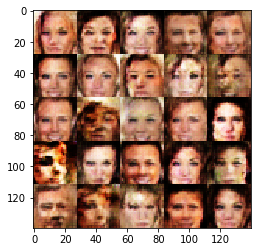

Epoch 1/1... Batch 4775 Discriminator Loss: 1.3368... Generator Loss: 0.6979


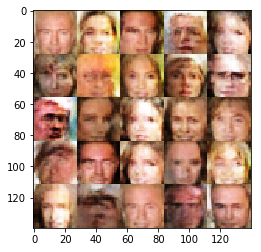

Epoch 1/1... Batch 4800 Discriminator Loss: 1.4962... Generator Loss: 0.9058


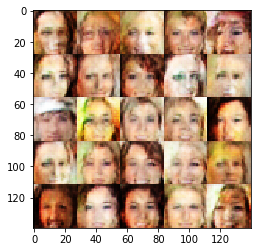

Epoch 1/1... Batch 4825 Discriminator Loss: 1.3492... Generator Loss: 0.6623


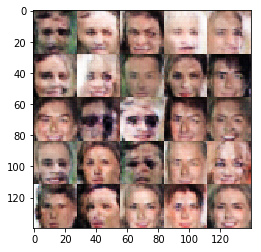

Epoch 1/1... Batch 4850 Discriminator Loss: 1.3349... Generator Loss: 0.5618


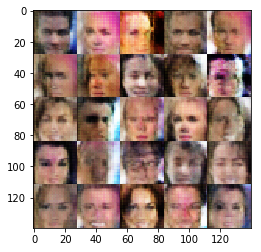

Epoch 1/1... Batch 4875 Discriminator Loss: 1.3616... Generator Loss: 0.7208


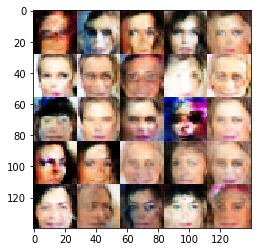

Epoch 1/1... Batch 4900 Discriminator Loss: 1.3905... Generator Loss: 0.7194


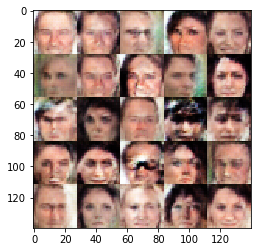

Epoch 1/1... Batch 4925 Discriminator Loss: 1.2747... Generator Loss: 0.6423


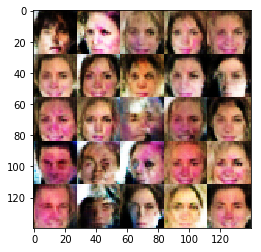

Epoch 1/1... Batch 4950 Discriminator Loss: 1.4670... Generator Loss: 0.5780


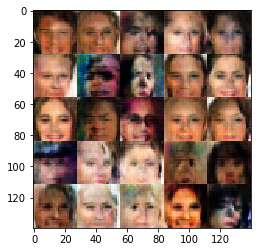

Epoch 1/1... Batch 4975 Discriminator Loss: 1.3794... Generator Loss: 0.5254


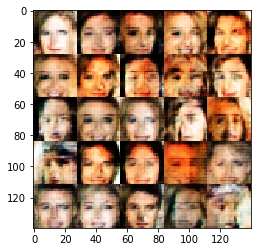

Epoch 1/1... Batch 5000 Discriminator Loss: 1.3985... Generator Loss: 0.4944


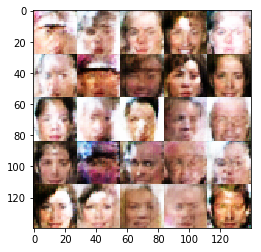

Epoch 1/1... Batch 5025 Discriminator Loss: 1.2865... Generator Loss: 0.7886


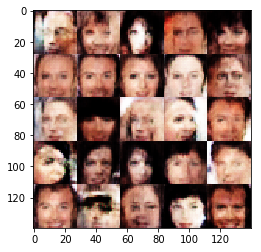

Epoch 1/1... Batch 5050 Discriminator Loss: 1.4320... Generator Loss: 0.8041


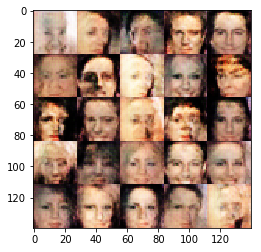

Epoch 1/1... Batch 5075 Discriminator Loss: 1.3686... Generator Loss: 0.5329


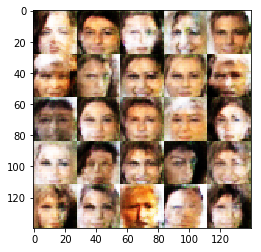

Epoch 1/1... Batch 5100 Discriminator Loss: 1.5166... Generator Loss: 0.5439


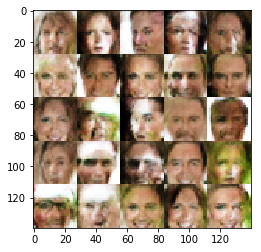

Epoch 1/1... Batch 5125 Discriminator Loss: 1.2534... Generator Loss: 0.8450


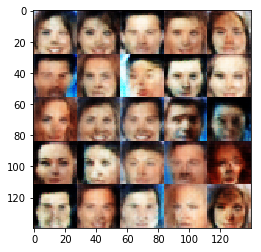

Epoch 1/1... Batch 5150 Discriminator Loss: 1.1693... Generator Loss: 0.8247


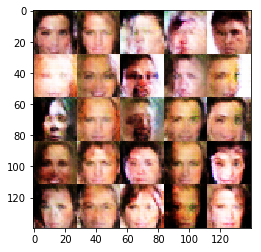

Epoch 1/1... Batch 5175 Discriminator Loss: 2.0067... Generator Loss: 1.9128


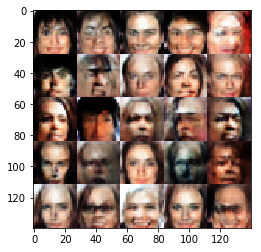

Epoch 1/1... Batch 5200 Discriminator Loss: 1.2236... Generator Loss: 0.8708


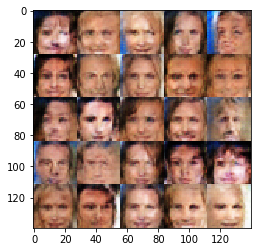

Epoch 1/1... Batch 5225 Discriminator Loss: 1.5597... Generator Loss: 0.4229


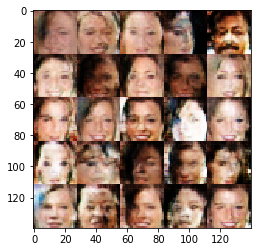

Epoch 1/1... Batch 5250 Discriminator Loss: 1.3921... Generator Loss: 0.5136


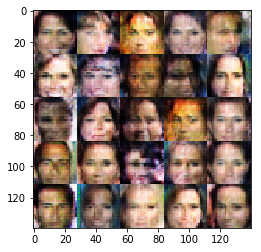

Epoch 1/1... Batch 5275 Discriminator Loss: 1.3359... Generator Loss: 0.5657


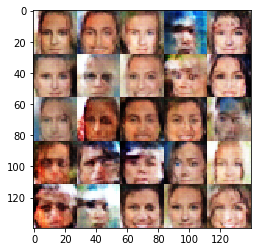

Epoch 1/1... Batch 5300 Discriminator Loss: 1.2721... Generator Loss: 0.6992


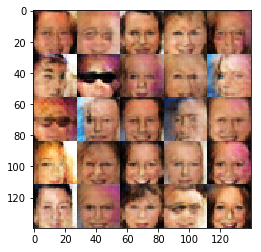

Epoch 1/1... Batch 5325 Discriminator Loss: 1.4154... Generator Loss: 0.7087


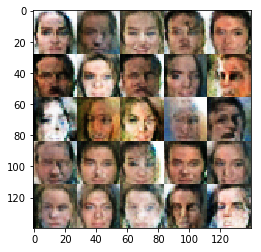

Epoch 1/1... Batch 5350 Discriminator Loss: 1.2814... Generator Loss: 0.6506


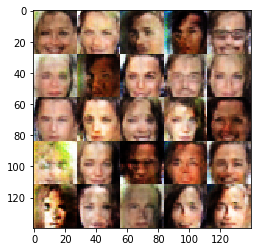

Epoch 1/1... Batch 5375 Discriminator Loss: 1.4165... Generator Loss: 0.5714


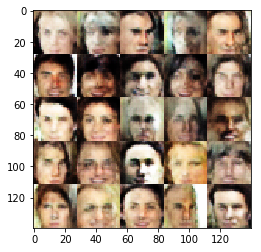

Epoch 1/1... Batch 5400 Discriminator Loss: 1.5342... Generator Loss: 0.3950


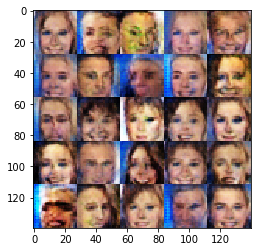

Epoch 1/1... Batch 5425 Discriminator Loss: 1.3713... Generator Loss: 0.5776


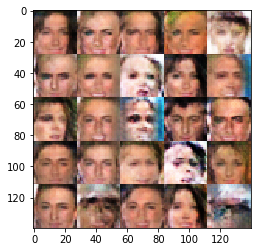

Epoch 1/1... Batch 5450 Discriminator Loss: 1.3209... Generator Loss: 0.7001


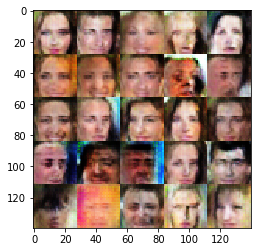

Epoch 1/1... Batch 5475 Discriminator Loss: 1.7594... Generator Loss: 0.9630


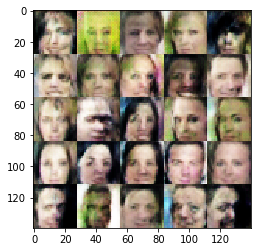

Epoch 1/1... Batch 5500 Discriminator Loss: 1.5125... Generator Loss: 0.4528


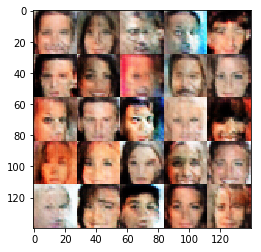

Epoch 1/1... Batch 5525 Discriminator Loss: 1.3591... Generator Loss: 0.6426


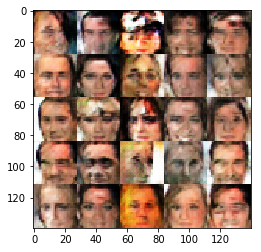

Epoch 1/1... Batch 5550 Discriminator Loss: 1.4493... Generator Loss: 0.5649


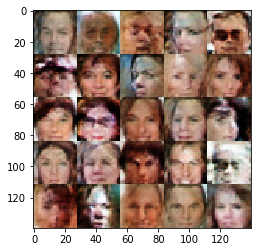

Epoch 1/1... Batch 5575 Discriminator Loss: 1.2977... Generator Loss: 0.6390


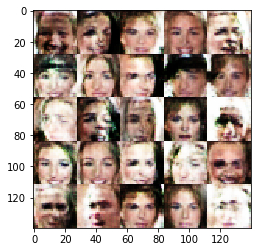

Epoch 1/1... Batch 5600 Discriminator Loss: 1.3984... Generator Loss: 0.5819


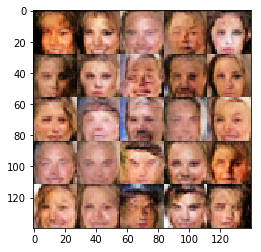

Epoch 1/1... Batch 5625 Discriminator Loss: 1.8748... Generator Loss: 1.9879


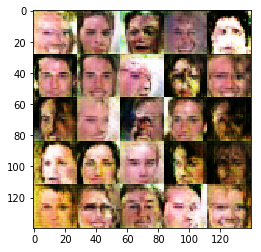

Epoch 1/1... Batch 5650 Discriminator Loss: 1.2892... Generator Loss: 0.7422


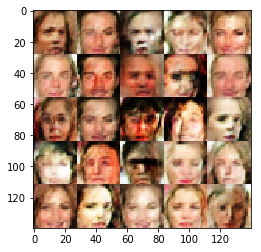

Epoch 1/1... Batch 5675 Discriminator Loss: 1.2809... Generator Loss: 1.2893


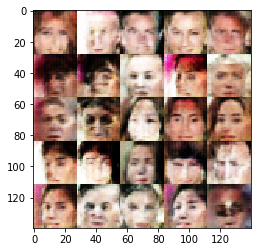

Epoch 1/1... Batch 5700 Discriminator Loss: 1.4332... Generator Loss: 1.0353


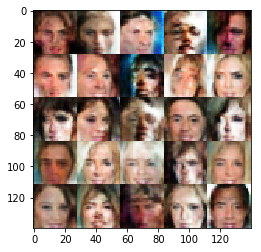

Epoch 1/1... Batch 5725 Discriminator Loss: 1.2766... Generator Loss: 0.6061


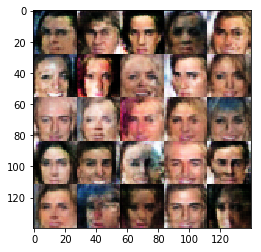

Epoch 1/1... Batch 5750 Discriminator Loss: 1.4687... Generator Loss: 0.4274


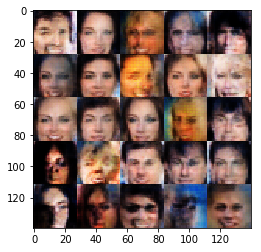

Epoch 1/1... Batch 5775 Discriminator Loss: 1.4849... Generator Loss: 0.4200


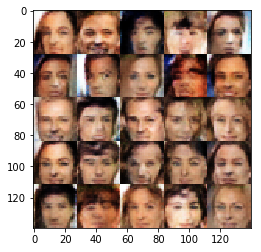

Epoch 1/1... Batch 5800 Discriminator Loss: 1.0958... Generator Loss: 1.6752


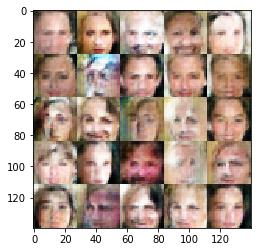

Epoch 1/1... Batch 5825 Discriminator Loss: 1.3896... Generator Loss: 0.8014


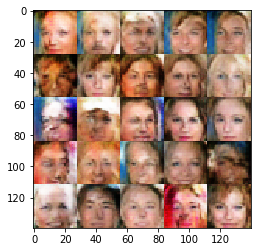

Epoch 1/1... Batch 5850 Discriminator Loss: 1.5281... Generator Loss: 0.4013


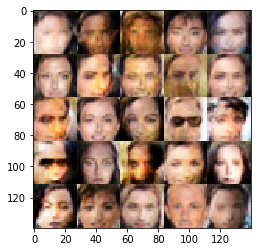

Epoch 1/1... Batch 5875 Discriminator Loss: 1.2380... Generator Loss: 0.9023


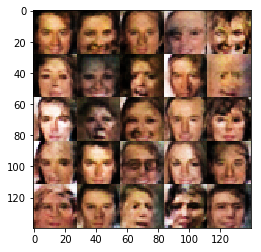

Epoch 1/1... Batch 5900 Discriminator Loss: 1.3913... Generator Loss: 0.4706


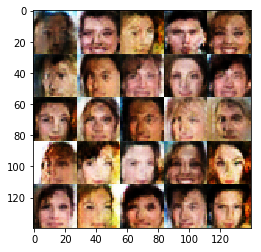

Epoch 1/1... Batch 5925 Discriminator Loss: 1.5354... Generator Loss: 0.3871


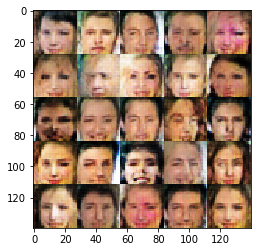

Epoch 1/1... Batch 5950 Discriminator Loss: 1.4358... Generator Loss: 1.0589


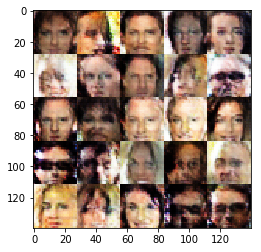

Epoch 1/1... Batch 5975 Discriminator Loss: 1.3545... Generator Loss: 0.6395


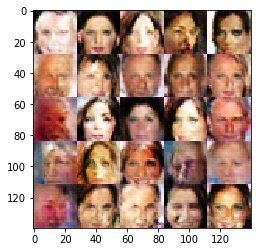

Epoch 1/1... Batch 6000 Discriminator Loss: 1.3052... Generator Loss: 0.5618


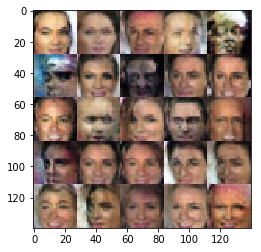

Epoch 1/1... Batch 6025 Discriminator Loss: 1.1767... Generator Loss: 0.7316


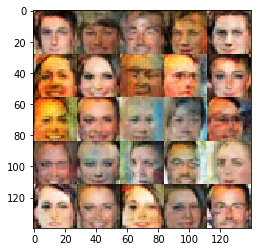

Epoch 1/1... Batch 6050 Discriminator Loss: 1.3444... Generator Loss: 0.5300


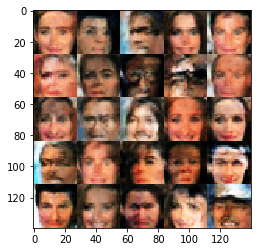

Epoch 1/1... Batch 6075 Discriminator Loss: 1.2373... Generator Loss: 0.6791


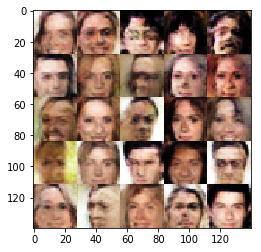

Epoch 1/1... Batch 6100 Discriminator Loss: 1.2305... Generator Loss: 0.6362


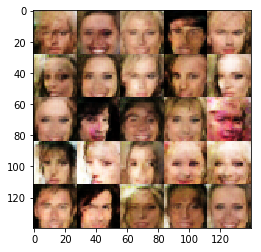

Epoch 1/1... Batch 6125 Discriminator Loss: 1.3708... Generator Loss: 0.4917


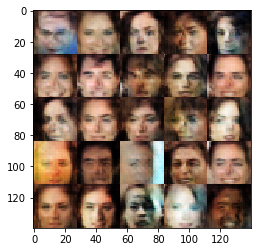

Epoch 1/1... Batch 6150 Discriminator Loss: 1.3100... Generator Loss: 0.5825


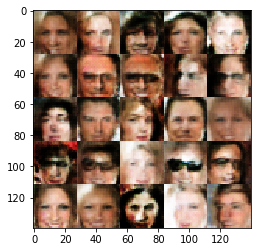

Epoch 1/1... Batch 6175 Discriminator Loss: 1.3774... Generator Loss: 0.4890


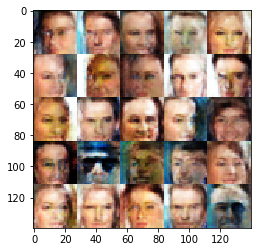

Epoch 1/1... Batch 6200 Discriminator Loss: 1.2477... Generator Loss: 0.7341


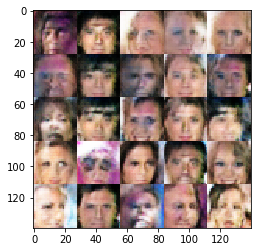

Epoch 1/1... Batch 6225 Discriminator Loss: 1.4748... Generator Loss: 1.0539


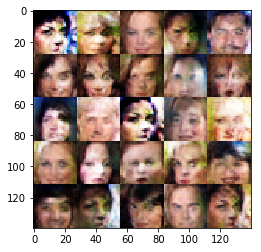

Epoch 1/1... Batch 6250 Discriminator Loss: 1.3815... Generator Loss: 0.7939


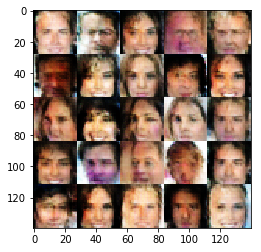

Epoch 1/1... Batch 6275 Discriminator Loss: 1.4291... Generator Loss: 0.4262


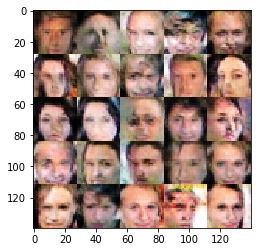

Epoch 1/1... Batch 6300 Discriminator Loss: 1.3511... Generator Loss: 0.6128


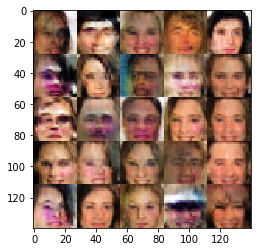

Epoch 1/1... Batch 6325 Discriminator Loss: 1.4776... Generator Loss: 1.9493


In [13]:
batch_size = 32
z_dim = 50
learning_rate = 0.01
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.